In [34]:
import numpy as np
from keras.models import Sequential, load_model
from keras.layers import Dense, LSTM, Dropout, Activation
from sklearn.preprocessing import MinMaxScaler
import os
import matplotlib.pyplot as plt
import sys
from keras.utils.vis_utils import plot_model
import time

In [35]:
timesteps = seq_length = 10
data_dim = 50

In [36]:
xy = np.loadtxt('./data/health_161.csv', delimiter=',',skiprows=1)
type(xy)

numpy.ndarray

In [38]:
xy.shape[1]

58

In [84]:
#xy = xy[::-1]

In [39]:
scaler = MinMaxScaler(feature_range=(0, 1))
xy = scaler.fit_transform(xy)

In [40]:
x = xy[:,8:xy.shape[1]]
y = xy[:, 0]

In [33]:
#xy[1,1:len(xy[1,:])]
#type(x)
x.shape
#y[0]

(6360, 50)

In [41]:
dataX = []
dataY = []
for i in range(0, len(y) - seq_length):
    _x = x[i:i + seq_length]
    _y = y[i + seq_length]  # Next close price
    print(_x, "->", _y)
    dataX.append(_x)
    dataY.append(_y)

[[1.00000000e+00 6.74955595e-02 4.98399001e-04 2.73861773e-03
  0.00000000e+00 0.00000000e+00 0.00000000e+00 5.18976400e-03
  0.00000000e+00 1.53672400e-03 9.31755082e-02 3.89337736e-03
  2.78153945e-01 0.00000000e+00 1.65696408e-03 0.00000000e+00
  2.47595427e-02 1.81201761e-02 8.61008610e-03 3.27330936e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 9.55737395e-03
  1.52997334e-03 9.97427828e-01 3.55258908e-03 0.00000000e+00
  1.80327869e-01 1.42857143e-01 0.00000000e+00 0.00000000e+00
  1.67182720e-05 9.93518185e-01 1.58730159e-02 2.35294118e-01
  1.16101759e-02 0.00000000e+00 1.87468799e-03 1.88696039e-01
  8.21602171e-01 1.09050198e-03 5.88562453e-01 6.41414482e-04
  1.21857165e-02 1.68878166e-02]
 [1.00000000e+00 0.00000000e+00 8.85007572e-05 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 4.60792973e-03
  0.00000000e+00 1.53672400e-03 9.31755082e-02 2.32367680e-03
  8.50434992e-01 0.00000000e+00 1.324

  8.48372667e-03 2.53317250e-02]] -> 0.7400000000000002
[[1.00000000e+00 7.28241563e-02 1.63945989e-02 1.18136451e-04
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.80961418e-03
  0.00000000e+00 2.75592009e-02 9.11576599e-02 7.73150646e-03
  9.69098471e-01 0.00000000e+00 1.87626632e-01 0.00000000e+00
  1.72098221e-01 5.39976478e-01 1.59901599e-02 9.71893431e-01
  0.00000000e+00 3.85062625e-01 9.81643271e-05 0.00000000e+00
  0.00000000e+00 2.72727273e-01 0.00000000e+00 4.29258488e-03
  2.75551652e-02 9.97787070e-01 5.38271073e-03 4.57827381e-01
  1.80327869e-01 2.85714286e-01 0.00000000e+00 0.00000000e+00
  5.61077707e-04 8.95570760e-01 1.58730159e-02 1.17647059e-01
  9.70785838e-03 8.48896435e-04 9.23043321e-04 2.02937250e-01
  7.83192220e-01 1.59309771e-03 4.13569265e-01 1.02978626e-01
  8.76137591e-02 7.15319662e-01]
 [1.00000000e+00 7.28241563e-02 3.20971619e-02 6.08581718e-05
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.60791156e-03
  0.00000000e+00 2.75592009e-02 9.33688647e

  7.09548049e-03 4.54764777e-01]] -> 0.45999999999999996
[[1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 1.15597648e-03
  0.00000000e+00 3.14750699e-04 1.59048091e-02 1.78419380e-03
  9.80370095e-01 0.00000000e+00 7.17942983e-05 0.00000000e+00
  4.17145877e-03 1.20451031e-02 5.65805658e-03 9.89082573e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 2.69721790e-03
  3.15400204e-04 9.99971261e-01 8.93529982e-03 5.30627986e-03
  4.91803279e-02 1.42857143e-01 0.00000000e+00 0.00000000e+00
  0.00000000e+00 1.00000000e+00 3.17460317e-02 1.17647059e-01
  1.58526459e-03 1.13186191e-03 4.89689649e-04 4.36137072e-02
  7.60869358e-01 5.18979319e-04 8.73667676e-01 2.14550059e-04
  8.79222582e-03 5.31966224e-01]
 [1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 5.35079300e-05
  0.00000000e+00 3.70294940e-05 1.59048091

  1.87258985e-01 2.17129071e-02]] -> 0.26000000000000023
[[1.00000000e+00 0.00000000e+00 5.64940924e-04 1.71727441e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 3.03968188e-02
  0.00000000e+00 9.93316176e-03 1.59048091e-02 1.63521849e-01
  2.57700267e-01 0.00000000e+00 6.20261317e-04 0.00000000e+00
  6.01596497e-02 2.46387340e-02 3.44403444e-03 5.98994102e-02
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 3.48332196e-02
  9.92885767e-03 9.98519924e-01 1.07654215e-02 2.10908727e-03
  1.63934426e-01 1.42857143e-01 6.66666667e-01 0.00000000e+00
  1.89503510e-05 9.72632337e-01 1.58730159e-02 1.17647059e-01
  2.92745527e-02 0.00000000e+00 2.32182230e-02 1.74009791e-01
  6.93774211e-01 1.36634214e-02 1.77798080e-01 2.72232349e-03
  2.08236927e-02 3.01568154e-02]
 [1.00000000e+00 0.00000000e+00 3.76627283e-04 1.41112201e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 2.61178239e-02
  0.00000000e+00 9.85910278e-03 1.59048091

  1.00262224e-02 2.29191797e-02]] -> 0.6200000000000001
[[1.00000000e+00 3.01953819e-02 1.14052856e-03 3.79006795e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 5.14950921e-02
  3.32907901e-02 7.08189073e-03 9.94050570e-03 2.99305822e-01
  2.25090916e-01 0.00000000e+00 5.13698559e-02 0.00000000e+00
  9.34070256e-02 1.09255650e-01 9.59409594e-03 2.93083946e-02
  0.00000000e+00 0.00000000e+00 3.23942279e-03 0.00000000e+00
  0.00000000e+00 9.09090909e-02 0.00000000e+00 5.35765866e-02
  7.07951723e-03 9.95861534e-01 1.64710948e-02 5.17478075e-03
  9.83606557e-02 1.42857143e-01 8.33333333e-02 0.00000000e+00
  1.38522825e-04 1.00000000e+00 1.58730159e-02 1.17647059e-01
  1.11421454e-02 8.48896435e-04 4.76775710e-02 1.01468625e-01
  5.82004720e-01 2.36080978e-02 7.86651921e-01 6.43050289e-03
  1.20314669e-02 3.89626055e-01]
 [1.00000000e+00 3.55239787e-02 1.14052856e-03 4.49004432e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 5.39437236e-02
  0.00000000e+00 6.99857436e-03 9.94050570e

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> 0.8600000000000003
[[1.00000000e+00 7.28241563e-02 2.04656338e-02 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 4.10929135e-03
  0.00000000e+00 1.90979615e-02 9.94050570e-03 8.97556727e-02
  9.94052762e-01 0.00000000e+00 5.00024852e-02 0.00000000e+00
  6.56374344e-02 2.74741968e-01 1.30381304e-02 9.97252969e-01
  0.00000000e+00 0.00000000e+00 3.92657308e-04 0.00000000e+00
  0.00000000e+00 4.54545455e-01 0.00000000e+00 9.54596035e-03
  1.90931453e-02 9.82526476e-01 2.91527613e-01 5.12642747e-01
  3.93442623e-01 2.85714286e-01 0.00000000e+00 0.00000000e+00
  6.86498228e-04 9.99639899e-01 1.58730159e-02 1.17647059e-01
  5.22080471e-02 8.48896435e-04 1.20385650e-03 3.76947040e-01
  6.65241650e-01 3.34200505e-03 3.25784168e-01 1.01237487e-01
  3.03871664e-02 2.77442702e-02]
 [1.00000000e+00 7.28241563e-02 2.04656338e-02 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 4.19092119e-03
  0.00000000e+00 1.55523875e-02 9.94050570e-03 8.97556727e-02
  9.93007977e-

  8.51457658e-02 3.13630881e-02]] -> 0.33000000000000007
[[1.00000000e+00 7.10479574e-02 1.33170350e-02 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 2.53386094e-03
  0.00000000e+00 2.01347874e-02 9.94050570e-03 6.81178543e-03
  9.56601234e-01 0.00000000e+00 4.16914322e-02 0.00000000e+00
  7.97687446e-02 1.22762512e-01 1.69741697e-02 9.82992648e-01
  0.00000000e+00 0.00000000e+00 5.88985963e-04 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 5.75645163e-03
  2.01311795e-02 9.54175109e-01 7.10517817e-03 2.47137688e-01
  4.26229508e-01 1.42857143e-01 5.83333333e-01 0.00000000e+00
  4.46705977e-04 1.00000000e+00 3.17460317e-02 1.17647059e-01
  1.47218238e-01 8.48896435e-04 8.50239905e-04 3.91188251e-01
  6.15671540e-01 8.75529364e-04 1.69271209e-01 3.34030518e-02
  1.41138362e-01 2.53317250e-02]
 [1.00000000e+00 7.10479574e-02 9.56872849e-04 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 2.05680879e-03
  0.00000000e+00 1.33306178e-03 1.39167080

  5.35246028e-02 4.02895054e-01]] -> 0.6400000000000001
[[1.00000000e+00 7.10479574e-02 1.52653825e-02 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 2.95198055e-04
  0.00000000e+00 1.31454704e-02 9.94050570e-03 9.19721029e-04
  9.85634205e-01 0.00000000e+00 4.70661674e-02 0.00000000e+00
  6.23453783e-02 3.35499665e-01 1.52521525e-02 9.87214188e-01
  0.00000000e+00 0.00000000e+00 1.96328654e-04 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 1.06985384e-03
  1.31441438e-02 9.94582633e-01 0.00000000e+00 3.87874220e-01
  4.42622951e-01 2.85714286e-01 8.33333333e-02 0.00000000e+00
  5.12061251e-04 1.00000000e+00 3.17460317e-02 0.00000000e+00
  2.18464558e-02 8.48896435e-04 3.17214888e-04 4.20115710e-01
  5.83796273e-01 4.69580299e-04 2.66769246e-01 3.47917973e-02
  3.96421410e-02 2.29191797e-02]
 [1.00000000e+00 6.92717584e-02 1.19575835e-02 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 4.85187641e-04
  0.00000000e+00 1.26270575e-02 9.94050570e

  1.11059695e-02 2.53317250e-02]] -> 0.9400000000000004
[[1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 4.60782414e-05
  0.00000000e+00 9.25737350e-06 7.95240456e-03 4.32236385e-04
  9.80329911e-01 0.00000000e+00 1.72582448e-05 0.00000000e+00
  9.91814286e-05 4.51791853e-04 0.00000000e+00 9.90244001e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 5.09807254e-04
  5.27672781e-06 9.98979753e-01 1.83012165e-03 1.97837332e-04
  3.11475410e-01 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 1.00000000e+00 3.17460317e-02 0.00000000e+00
  1.20782064e-03 0.00000000e+00 1.04004881e-04 2.75478416e-01
  8.93858923e-01 2.49311972e-04 8.07616483e-01 6.44379710e-06
  2.62224279e-03 1.82147165e-01]
 [1.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  1.53846154e-01 0.00000000e+00 0.00000000e+00 4.60782414e-05
  0.00000000e+00 9.25737350e-06 7.95240456e

[[1.00000000e+00 6.03907638e-02 5.94485538e-03 1.18136451e-04
  1.53846154e-01 0.00000000e+00 0.00000000e+00 7.90488453e-03
  9.70366300e-02 2.42543186e-03 7.95240456e-03 6.86703369e-03
  8.46959073e-01 0.00000000e+00 2.12776900e-03 0.00000000e+00
  8.34214236e-02 3.66524850e-03 1.00861009e-02 8.49640462e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 1.56669642e-02
  2.42118490e-03 8.86120332e-01 8.93529982e-03 5.51707378e-04
  3.27868852e-01 0.00000000e+00 0.00000000e+00 0.00000000e+00
  9.89542687e-02 1.00000000e+00 3.17460317e-02 1.76470588e-01
  1.84796558e-02 0.00000000e+00 2.19190287e-03 2.90164664e-01
  8.32615419e-01 1.27643096e-03 6.51904922e-01 2.35519890e-04
  1.55792072e-02 1.90591074e-01]
 [1.00000000e+00 4.97335702e-02 2.67964323e-03 1.18136451e-04
  1.53846154e-01 0.00000000e+00 0.00000000e+00 8.53709913e-03
  2.75281280e-02 2.24954176e-03 5.96430342e-03 6.86703369e-03
  8.91201704e-01 0.00000000e+00 3.589

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



-> 0.6400000000000001
[[1.00000000e+00 0.00000000e+00 7.71886304e-05 0.00000000e+00
  3.07692308e-01 0.00000000e+00 0.00000000e+00 6.62791304e-05
  0.00000000e+00 1.01831108e-04 1.19286068e-02 5.78481778e-03
  9.75588194e-01 0.00000000e+00 2.98567635e-04 0.00000000e+00
  5.94908362e-02 1.17664177e-03 8.85608856e-03 9.82406884e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 5.16343244e-04
  9.83137707e-05 9.97902028e-01 1.83012165e-03 3.15009141e-04
  4.26229508e-01 0.00000000e+00 0.00000000e+00 0.00000000e+00
  2.58921168e-06 1.00000000e+00 3.17460317e-02 5.88235294e-02
  1.05684306e-03 0.00000000e+00 5.04423674e-04 3.76947040e-01
  5.30557200e-01 6.74706212e-04 7.31083009e-01 2.11235587e-04
  4.47323770e-03 3.13630881e-02]
 [1.00000000e+00 0.00000000e+00 7.71886304e-05 0.00000000e+00
  3.07692308e-01 0.00000000e+00 0.00000000e+00 6.62791304e-05
  0.00000000e+00 1.01831108e-04 1.19286068e-02 1.18946253e-03
  9.75588194e-0

  1.09517199e-02 3.37756333e-02]] -> 0.7200000000000002
[[1.00000000e+00 0.00000000e+00 6.84450217e-03 1.82574515e-04
  3.07692308e-01 0.00000000e+00 0.00000000e+00 1.15187953e-03
  0.00000000e+00 1.53672400e-03 7.95240456e-03 9.17901086e-02
  9.82399389e-01 0.00000000e+00 2.26272847e-03 0.00000000e+00
  1.54767277e-03 7.79086378e-03 0.00000000e+00 9.93384907e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.72727273e-01 0.00000000e+00 3.49909613e-03
  1.53626839e-03 9.73732235e-01 3.02400689e-01 7.28936065e-04
  4.75409836e-01 0.00000000e+00 8.33333333e-02 0.00000000e+00
  2.29591649e-04 1.00000000e+00 1.58730159e-02 1.17647059e-01
  5.64052238e-02 0.00000000e+00 3.53616596e-04 4.78415665e-01
  7.56938372e-01 3.41060101e-03 6.20474107e-01 2.65191670e-04
  5.24448558e-03 2.65379976e-02]
 [1.00000000e+00 4.26287744e-02 6.84450217e-03 1.82574515e-04
  3.07692308e-01 0.00000000e+00 0.00000000e+00 1.15187953e-03
  0.00000000e+00 1.53672400e-03 7.95240456e

  4.47323770e-03 2.48492159e-01]] -> 0.8000000000000003
[[1.00000000e+00 0.00000000e+00 1.70393902e-02 4.88118337e-01
  2.30769231e-01 0.00000000e+00 0.00000000e+00 3.48307354e-02
  1.15631941e-01 8.49826887e-03 1.63237481e-02 5.22167552e-01
  3.25691668e-01 0.00000000e+00 4.58810438e-03 0.00000000e+00
  6.72869057e-02 5.40834507e-02 6.39606396e-03 3.89522905e-01
  0.00000000e+00 0.00000000e+00 1.91420438e-02 0.00000000e+00
  0.00000000e+00 9.09090909e-02 0.00000000e+00 6.31418623e-02
  8.49321741e-03 9.97039847e-01 1.83012165e-03 1.89446909e-03
  7.70491803e-01 0.00000000e+00 8.33333333e-02 0.00000000e+00
  1.16085185e-01 1.00000000e+00 1.58730159e-02 5.88235294e-02
  4.08243376e-02 1.41482739e-03 6.91372448e-02 6.80907877e-01
  6.53972738e-01 3.37424267e-02 5.18632495e-01 7.73974450e-03
  1.06432207e-02 2.87092883e-01]
 [1.00000000e+00 0.00000000e+00 9.28792158e-03 4.88118337e-01
  2.30769231e-01 0.00000000e+00 0.00000000e+00 7.44933585e-03
  8.91210304e-03 3.33265446e-03 1.83118493e

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 0.9400000000000004
[[1.00000000e+00 0.00000000e+00 8.62449861e-03 0.00000000e+00
  3.84615385e-01 0.00000000e+00 0.00000000e+00 7.07839567e-03
  1.24544044e-01 2.36988762e-03 1.78929103e-02 2.97365633e-03
  9.90958590e-01 0.00000000e+00 6.13175945e-01 0.00000000e+00
  1.03438994e-01 2.92057172e-01 5.41205412e-03 9.91021653e-01
  0.00000000e+00 7.62294041e-01 0.00000000e+00 0.00000000e+00
  0.00000000e+00 9.09090909e-02 0.00000000e+00 1.40680853e-02
  2.36323346e-03 9.96738084e-01 7.10517817e-03 4.99765009e-03
  3.93442623e-01 1.42857143e-01 0.00000000e+00 1.00000000e+00
  1.25500318e-01 1.00000000e+00 1.58730159e-02 5.88235294e-02
  1.78908432e-02 1.13186191e-03 1.97522604e-03 3.62260792e-01
  7.19905315e-01 9.45945722e-04 4.28651568e-01 4.65382975e-03
  1.54249576e-02 1.80940893e-02]
 [1.00000000e+00 0.00000000e+00 8.57925010e-03 0.00000000e+00
  3.84615385e-01 0.00000000e+00 0.00000000e+00 1.50194633e-03
  1.53473446e-02 4.44353928e-04 1.59048091e-02 2.97365633e-03
  9.65863656e-01 

  5.09023600e-02 2.53317250e-02]] -> 0.6900000000000004
[[1.00000000e+00 7.46003552e-02 4.08707144e-02 5.15869663e-01
  3.84615385e-01 0.00000000e+00 0.00000000e+00 1.40760298e-03
  0.00000000e+00 2.56614393e-02 1.78929103e-02 6.12020721e-02
  2.43033092e-01 0.00000000e+00 1.93332036e-01 0.00000000e+00
  1.24230525e-01 3.16843288e-01 1.54981550e-02 5.43649511e-02
  0.00000000e+00 0.00000000e+00 9.81643271e-05 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 4.29092649e-03
  2.56560060e-02 9.87915104e-01 3.21886102e-02 4.87006474e-01
  6.55737705e-01 2.85714286e-01 0.00000000e+00 1.00000000e+00
  1.37096526e-03 9.99639899e-01 1.58730159e-02 1.17647059e-01
  4.76032309e-02 1.41482739e-03 6.28657505e-02 6.37739208e-01
  6.52432397e-01 2.49568483e-03 3.15077495e-01 1.19913893e-01
  3.70198982e-02 3.61881785e-02]
 [1.00000000e+00 7.46003552e-02 4.08707144e-02 4.82719859e-01
  3.84615385e-01 0.00000000e+00 0.00000000e+00 3.80487533e-02
  1.24564758e-01 3.06881931e-02 1.78929103e

[[1.00000000e+00 7.28241563e-02 4.55419573e-02 1.48923526e-03
  4.61538462e-01 0.00000000e+00 0.00000000e+00 4.18622215e-03
  0.00000000e+00 2.20695784e-02 5.96430342e-03 1.02037036e-01
  9.71951538e-01 0.00000000e+00 9.73898285e-02 0.00000000e+00
  1.02159089e-01 3.27187070e-01 1.35301353e-02 9.87244486e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 1.03202313e-02
  2.20669054e-02 9.91665589e-01 3.13489073e-01 5.34898564e-01
  6.06557377e-01 2.85714286e-01 8.33333333e-02 1.00000000e+00
  1.52950984e-03 9.90637378e-01 1.58730159e-02 1.76470588e-01
  5.36121386e-02 1.13186191e-03 1.22552418e-03 5.36270583e-01
  5.89759848e-01 4.37557818e-03 3.21280313e-01 1.00946122e-01
  4.90513651e-02 4.82509047e-01]
 [1.00000000e+00 7.28241563e-02 4.43688232e-02 1.55009344e-03
  4.61538462e-01 0.00000000e+00 0.00000000e+00 4.18622215e-03
  0.00000000e+00 2.18751736e-02 5.96430342e-03 9.75326777e-02
  9.68154146e-01 0.00000000e+00 2.465

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> 0.73
[[1.00000000e+00 0.00000000e+00 0.00000000e+00 1.42837709e-03
  5.38461538e-01 0.00000000e+00 0.00000000e+00 2.68515423e-04
  0.00000000e+00 7.40589880e-05 9.94050570e-03 2.50242117e-03
  8.37917663e-01 0.00000000e+00 1.10970514e-04 0.00000000e+00
  8.04546751e-04 4.10792948e-04 5.41205412e-03 8.14353236e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 9.92202368e-04
  7.17449833e-05 9.99597649e-01 3.76789751e-03 2.75853247e-04
  4.91803279e-01 0.00000000e+00 0.00000000e+00 1.00000000e+00
  0.00000000e+00 1.00000000e+00 3.17460317e-02 1.17647059e-01
  2.02309957e-03 0.00000000e+00 2.01942811e-04 4.34801958e-01
  5.90051762e-01 3.32057399e-04 9.26335529e-01 1.09325050e-05
  5.70723431e-03 3.37756333e-02]
 [1.00000000e+00 0.00000000e+00 3.32709614e-05 1.42837709e-03
  5.38461538e-01 0.00000000e+00 0.00000000e+00 2.68515423e-04
  0.00000000e+00 7.40589880e-05 9.94050570e-03 3.08415285e-03
  8.37917663e-01 0.00000000e

  9.96452260e-02 1.82147165e-01]] -> 0.8200000000000003
[[1.00000000e+00 0.00000000e+00 2.19588345e-05 0.00000000e+00
  5.38461538e-01 0.00000000e+00 0.00000000e+00 7.13344949e-04
  0.00000000e+00 7.40589880e-05 8.73723352e-02 1.51445229e-03
  9.91521167e-01 0.00000000e+00 1.00442985e-04 0.00000000e+00
  2.51044847e-04 4.90647024e-04 0.00000000e+00 9.91587218e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 0.00000000e+00 0.00000000e+00 4.93613606e-04
  7.37816151e-05 9.99353365e-01 3.55258908e-03 2.30809926e-04
  3.60655738e-01 0.00000000e+00 0.00000000e+00 1.00000000e+00
  7.36586081e-07 1.00000000e+00 1.58730159e-02 5.88235294e-02
  2.88367177e-03 0.00000000e+00 1.87208786e-04 3.33333333e-01
  5.45103948e-01 2.69998329e-04 9.39061724e-01 2.78475463e-04
  6.94123091e-03 3.51025332e-01]
 [1.00000000e+00 0.00000000e+00 1.77001514e-04 0.00000000e+00
  5.38461538e-01 0.00000000e+00 0.00000000e+00 7.54977221e-03
  0.00000000e+00 1.57375349e-03 8.93604363e

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> 0.7200000000000002
[[1.00000000e+00 5.86145648e-02 3.47615004e-03 4.43631013e-01
  6.92307692e-01 0.00000000e+00 0.00000000e+00 3.85605613e-02
  0.00000000e+00 1.81564866e-01 9.94050570e-03 2.80482415e-01
  2.13919752e-01 0.00000000e+00 1.33756402e-01 0.00000000e+00
  8.89389818e-02 1.30398759e-01 9.10209102e-03 3.02880343e-02
  0.00000000e+00 0.00000000e+00 1.47246491e-02 0.00000000e+00
  0.00000000e+00 1.81818182e-01 0.00000000e+00 3.73626479e-02
  1.81560632e-01 9.57393916e-01 1.07654215e-02 3.84687626e-02
  6.55737705e-01 2.85714286e-01 0.00000000e+00 1.00000000e+00
  1.16603809e-04 1.00000000e+00 0.00000000e+00 5.88235294e-02
  1.97629652e-02 8.48896435e-04 5.56989475e-02 5.79884290e-01
  3.98819241e-01 3.17477655e-02 5.52323252e-02 9.76034781e-02
  1.07974703e-02 1.80940893e-02]
 [1.00000000e+00 4.08525755e-02 4.39575942e-03 4.43169207e-01
  6.92307692e-01 0.00000000e+00 0.00000000e+00 2.62083619e-02
  1.24549981e-01 5.82288793e-03 9.94050570e-03 1.55923588e-01
  2.08314078e-

  7.01835570e-02 2.65379976e-02]] -> 0.6800000000000002
[[1.00000000e+00 7.28241563e-02 4.82149464e-02 8.34114943e-04
  6.92307692e-01 0.00000000e+00 0.00000000e+00 1.79687332e-03
  0.00000000e+00 2.47819889e-02 5.96430342e-03 8.00124796e-03
  9.51497860e-01 0.00000000e+00 4.99947190e-02 0.00000000e+00
  1.06599331e-01 3.18167311e-01 1.42681427e-02 9.41090329e-01
  0.00000000e+00 0.00000000e+00 4.02473741e-03 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 5.60544099e-03
  2.47830316e-02 9.88259976e-01 8.93529982e-03 6.03040277e-01
  6.72131148e-01 2.85714286e-01 8.33333333e-02 1.00000000e+00
  1.82695669e-03 9.99279798e-01 1.42857143e-01 5.88235294e-02
  6.31690194e-02 8.48896435e-04 1.39886565e-03 5.94125501e-01
  6.28231489e-01 1.19211337e-03 2.96837685e-01 9.61516125e-02
  4.81258677e-02 2.53317250e-02]
 [1.00000000e+00 7.46003552e-02 4.51912814e-02 0.00000000e+00
  6.92307692e-01 0.00000000e+00 0.00000000e+00 1.79687332e-03
  0.00000000e+00 2.25417045e-02 5.96430342e

  1.14144686e-02 2.53317250e-02]] -> 0.8600000000000003
[[1.00000000e+00 7.28241563e-02 1.68484148e-02 6.08581718e-05
  7.69230769e-01 0.00000000e+00 0.00000000e+00 5.31762000e-04
  0.00000000e+00 1.72279721e-02 7.95240456e-03 8.37823609e-03
  9.38839887e-01 0.00000000e+00 1.36408994e-01 0.00000000e+00
  1.72832586e-01 3.34604925e-01 1.45141451e-02 9.62531308e-01
  0.00000000e+00 0.00000000e+00 0.00000000e+00 0.00000000e+00
  0.00000000e+00 2.72727273e-01 0.00000000e+00 1.68706595e-03
  1.72228693e-02 9.95143050e-01 1.78705996e-02 5.09265382e-01
  5.40983607e-01 1.42857143e-01 0.00000000e+00 1.00000000e+00
  5.65541865e-04 1.00000000e+00 4.76190476e-02 1.76470588e-01
  5.08492489e-02 8.48896435e-04 8.06904537e-04 5.21584335e-01
  6.37026442e-01 7.37840973e-04 2.65951820e-01 4.87793389e-02
  5.49128490e-02 3.49819059e-02]
 [1.00000000e+00 7.10479574e-02 1.68484148e-02 0.00000000e+00
  7.69230769e-01 0.00000000e+00 0.00000000e+00 3.18199275e-04
  0.00000000e+00 1.72279721e-02 9.94050570e

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 -> 0.8400000000000003
[[1.00000000e+00 6.92717584e-02 4.87086874e-04 6.25407213e-03
  8.46153846e-01 0.00000000e+00 0.00000000e+00 5.71575061e-03
  1.24549981e-01 2.58280721e-03 9.94050570e-03 1.48162833e-02
  6.12967391e-01 0.00000000e+00 3.39600665e-01 0.00000000e+00
  5.66552022e-02 7.88786773e-02 2.95202952e-03 6.24727317e-01
  0.00000000e+00 4.82705992e-01 0.00000000e+00 0.00000000e+00
  0.00000000e+00 9.09090909e-02 0.00000000e+00 1.21344077e-02
  2.58106049e-03 8.82944634e-01 1.24878889e-02 3.48187787e-03
  6.55737705e-01 1.42857143e-01 0.00000000e+00 1.00000000e+00
  1.40274895e-01 1.00000000e+00 1.58730159e-02 0.00000000e+00
  9.69276063e-03 8.48896435e-04 2.52385179e-03 6.08811749e-01
  4.64637343e-01 1.44572810e-03 6.95420814e-01 2.01627604e-03
  8.94647540e-03 1.76115802e-01]
 [1.00000000e+00 6.92717584e-02 4.03390444e-02 9.35067911e-03
  8.46153846e-01 0.00000000e+00 0.00000000e+00 5.71575061e-03
  7.22158958e-02 1.06459795e-02 1.50867625e-02 1.77866897e-02
  6.37499749e-

  3.68656486e-02 2.77442702e-02]] -> 0.79
[[1.00000000e+00 7.63765542e-02 4.98399001e-04 1.60737171e-03
  9.23076923e-01 0.00000000e+00 0.00000000e+00 7.72104942e-03
  0.00000000e+00 1.69409935e-03 1.19286068e-02 2.97365633e-03
  8.93954311e-01 0.00000000e+00 2.92872414e-04 0.00000000e+00
  7.26600140e-02 1.40843297e-03 4.02706027e-01 8.14504727e-01
  0.00000000e+00 0.00000000e+00 1.89751644e-01 0.00000000e+00
  0.00000000e+00 3.63636364e-01 0.00000000e+00 1.57183741e-02
  1.69123755e-03 9.17086980e-01 3.55258908e-03 2.98354888e-01
  4.26229508e-01 0.00000000e+00 0.00000000e+00 1.00000000e+00
  1.67182720e-05 1.00000000e+00 3.17460317e-02 5.88235294e-02
  3.62346192e-04 3.67855122e-03 2.01856140e-03 3.76947040e-01
  4.70625085e-01 1.44266652e-03 4.04176884e-01 3.60208427e-04
  1.28027148e-02 3.61881785e-02]
 [1.00000000e+00 7.10479574e-02 3.25622899e-02 2.08349741e-03
  9.23076923e-01 0.00000000e+00 0.00000000e+00 2.24901048e-03
  0.00000000e+00 1.15069153e-02 1.01760040e-02 1.12446458

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [43]:
len(dataX)

6350

In [44]:
train_size = int(len(dataY) * 0.6)
valid_size = int(len(dataY) * 0.8) - train_size 
test_size = len(dataY) - valid_size
trainX, validX, testX = np.array(dataX[0:train_size]), np.array(dataX[train_size:train_size+valid_size]), np.array(
    dataX[train_size+valid_size:len(dataX)])
trainY, validY, testY = np.array(dataY[0:train_size]), np.array(dataY[train_size:train_size+valid_size]),np.array(
    dataY[train_size+valid_size:len(dataY)])

In [32]:
validX

array([[[1.00000000e+02, 3.90000000e-02, 8.80050000e+01, ...,
         1.49669406e+06, 1.92900000e+00, 7.01000000e+01],
        [1.00000000e+02, 4.00000000e-02, 4.58990000e+01, ...,
         4.36053568e+05, 9.05000000e-01, 2.70000000e+01],
        [1.00000000e+02, 3.90000000e-02, 1.73180000e+01, ...,
         2.98154650e+05, 9.43000000e-01, 4.30000000e+00],
        ...,
        [1.00000000e+02, 3.80000000e-02, 2.20430000e+01, ...,
         2.17549493e+05, 3.81000000e-01, 2.47000000e+01],
        [1.00000000e+02, 3.80000000e-02, 1.30430000e+01, ...,
         2.17549493e+05, 3.81000000e-01, 2.87000000e+01],
        [1.00000000e+02, 3.80000000e-02, 2.28080000e+01, ...,
         2.20881864e+05, 5.10000000e-01, 4.22000000e+01]],

       [[1.00000000e+02, 4.00000000e-02, 4.58990000e+01, ...,
         4.36053568e+05, 9.05000000e-01, 2.70000000e+01],
        [1.00000000e+02, 3.90000000e-02, 1.73180000e+01, ...,
         2.98154650e+05, 9.43000000e-01, 4.30000000e+00],
        [1.00000000e+02, 

model = Sequential()
model.add(LSTM(1, input_shape=(seq_length, data_dim), return_sequences=False))
# model.add(Dense(1))
model.add(Activation("linear"))
model.compile(loss='mean_squared_error', optimizer='adam')

model.summary()
#plot_model(model, to_file=os.path.basename('model') + '.png', show_shapes=True)
#plot_model(model, to_file='model.png', show_shapes=True)
print(trainX.shape, trainY.shape)

In [45]:
model = Sequential()
model.add(LSTM(32, input_shape=(timesteps, data_dim), return_sequences=True))
model.add(Dropout(0.5))
model.add(LSTM(8, return_sequences=True))
model.add(Dropout(0.5))
model.add(LSTM(2, return_sequences=False))
model.add(Dropout(0.5))
model.add(Dense(8,activation = 'relu'))
model.add(Dropout(0.5))
model.add(Dense(1))
model.add(Activation('linear'))
model.compile(loss='mean_squared_error', optimizer='adam')
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 10, 32)            10624     
_________________________________________________________________
dropout_1 (Dropout)          (None, 10, 32)            0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 10, 8)             1312      
_________________________________________________________________
dropout_2 (Dropout)          (None, 10, 8)             0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 2)                 88        
_________________________________________________________________
dropout_3 (Dropout)          (None, 2)                 0         
_________________________________________________________________
dense_1 (Dense)              (None, 8)                 24        
__________

In [49]:
model.fit(trainX, trainY, epochs=100, verbose=2, batch_size=32, validation_data=(validX, validY))

Train on 3810 samples, validate on 1270 samples
Epoch 1/100
 - 2s - loss: 0.0159 - val_loss: 0.0112
Epoch 2/100
 - 2s - loss: 0.0157 - val_loss: 0.0109
Epoch 3/100
 - 2s - loss: 0.0160 - val_loss: 0.0108
Epoch 4/100
 - 2s - loss: 0.0160 - val_loss: 0.0110
Epoch 5/100
 - 2s - loss: 0.0157 - val_loss: 0.0110
Epoch 6/100
 - 2s - loss: 0.0159 - val_loss: 0.0114
Epoch 7/100
 - 2s - loss: 0.0162 - val_loss: 0.0109
Epoch 8/100
 - 2s - loss: 0.0157 - val_loss: 0.0107
Epoch 9/100
 - 2s - loss: 0.0156 - val_loss: 0.0107
Epoch 10/100
 - 2s - loss: 0.0159 - val_loss: 0.0108
Epoch 11/100
 - 2s - loss: 0.0161 - val_loss: 0.0114
Epoch 12/100
 - 2s - loss: 0.0159 - val_loss: 0.0109
Epoch 13/100
 - 2s - loss: 0.0157 - val_loss: 0.0111
Epoch 14/100
 - 2s - loss: 0.0159 - val_loss: 0.0105
Epoch 15/100
 - 2s - loss: 0.0161 - val_loss: 0.0105
Epoch 16/100
 - 2s - loss: 0.0161 - val_loss: 0.0112
Epoch 17/100
 - 2s - loss: 0.0157 - val_loss: 0.0108
Epoch 18/100
 - 2s - loss: 0.0158 - val_loss: 0.0107
Epoch 1

In [50]:
#model.save('./models/health_'+ time.strftime('%Y-%m-%d_%H:%M:%S', time.localtime()) + '.h5')
model.save('./models/health.h5')
#plot_model(model, to_file='./models/model.png', show_shapes=True, show_layer_names=True)

In [52]:
loadModel = load_model('./models/health.h5')
#loss = model.evaluate(x=testX, y=testY, batch_size=2)

In [65]:
a_testX = testX[0].reshape(1,10,50)
a_testY = testY[0]

In [63]:
a_testPredict = loadModel.predict(a_testX)

In [67]:
print (a_testPredict)
print (a_testY)

[[0.7868129]]
0.7400000000000002


In [68]:
testPredict = loadModel.predict(testX)

In [54]:
print (testPredict)

[[0.7868129 ]
 [0.7607886 ]
 [0.7527512 ]
 ...
 [0.6351008 ]
 [0.63953394]
 [0.71325964]]


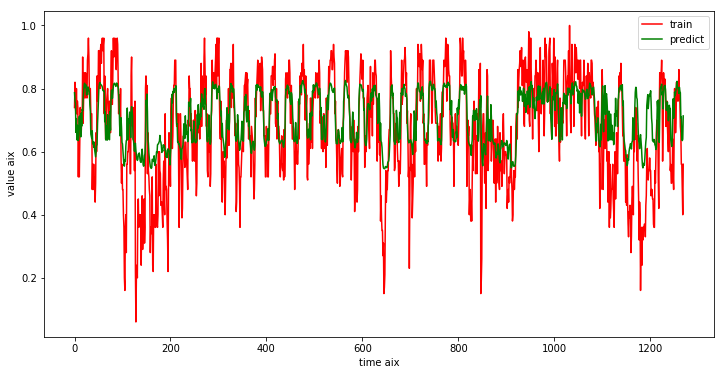

<Figure size 432x288 with 0 Axes>

In [55]:
plt.figure(figsize=(12,6))
plt.plot(testY,c='r',label="train")
plt.plot(testPredict,c='g',label="predict")
plt.xlabel("time aix")
plt.ylabel("value aix")
plt.legend() 
plt.show()
plt.savefig('reslut.jpg')

In [21]:
print (model.layers)

[<keras.layers.recurrent.LSTM object at 0x0000022E0FD670F0>, <keras.layers.core.Dropout object at 0x0000022E0FD67128>, <keras.layers.recurrent.LSTM object at 0x0000022E0BA6D470>, <keras.layers.core.Dense object at 0x0000022E0FD67438>, <keras.layers.core.Dropout object at 0x0000022E100A56A0>, <keras.layers.core.Dense object at 0x0000022E100A5E10>, <keras.layers.core.Dropout object at 0x0000022E101CB748>, <keras.layers.core.Dense object at 0x0000022E101CB828>, <keras.layers.core.Dropout object at 0x0000022E1021D588>, <keras.layers.core.Dense object at 0x0000022E1021D668>, <keras.layers.core.Activation object at 0x0000022E102783C8>]


In [50]:
import time
print ("local time is "+time.strftime("%Y-%m-%d_%H:%M:%S", time.localtime()))

local time is 2018-06-11_14:59:58
